# Exploratory Data Analysis of Divvy Bike Rides in Chicago

## Contents

## 1. Introduction to Notebook

The [Chicago Divvy bike share system](https://divvybikes.com/explore-chicago) is a bike rental system for people in the Chicagoland area. Users can pick up a bike at an established station and return it at another. Users rent the bike to commute to work, for other short trips, or to explore the city in their leisure time. The system has three different options of payment. A member is billed \\$119 annually, \\$1 to unlock plus \\$0.16 a minute for non-members, and $15 for 24 hours and \\$0.16 a minute after the first three hours.

In this notebook I will explore [trip data](https://divvy-tripdata.s3.amazonaws.com/index.html) for years 2018 - Oct. 2022. The data contains an ID and starting time and ending time for each trip, and the stations from which the bike is rented and returned with their respective IDs and locations in latitude and longitude. The questions I seek to answer in this analysis are the following:

* How does trip duration change over the seasons?
* How does trip duration change during weekdays compared to weekends throughout the year?
* How do the number of bookings change throughout the years and across each year?
* How do the the number of bookings change during the week for each month of the year and throughout the year?
* How do the the number of bookings change during the day for each month of the year?
* How do the the number of bookings change during a weekday and weekend for each month of the year?
* What are the most popular stations?

Exploring these questions can help the company ensure high bike availability and plan future bike locations to better distribute the available bikes for rental.

## 2. Imports

In [1]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import pandas as pd
import dask.dataframe as dd
import hvplot.dask
import plotly.express as px
import numpy as np

## 3. Data wrangling

Before carrying out the analysis, first I need to do a bit of data wrangling. Not all the available data contain the same headers. For example, the starting station in some spreadsheets is labeled as 'start_station', and in others, it is labeled 'from_station_name'. In the next few cells, I will work to make the column names consistent across all the data. Additionally, we will see that the data is quite large for each year. The python library, Dask, which is used for parallel computing, will allow me to work effectively and process the faster than only using Pandas.

In the cells below we can see how different the columns of the spreadsheets from 2020 - 2022 can be compared to those from 2018 - 2019. The columns that I will need in this notebook are the starting and ending times of the trip and the starting and ending stations with their latitude and longitude.

In [2]:
df = dd.read_csv('202201-divvy-tripdata.csv')
df.head(5)

,ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual
0,C2F7DD78E82EC875,electric_bike,2022-01-13 11:59:47,2022-01-13 12:02:44,Glenwood Ave & Touhy Ave,525,Clark St & Touhy Ave,RP-007,42.012800,-87.665906,42.012560,-87.674367,casual
1,A6CF8980A652D272,electric_bike,2022-01-10 08:41:56,2022-01-10 08:46:17,Glenwood Ave & Touhy Ave,525,Clark St & Touhy Ave,RP-007,42.012763,-87.665967,42.012560,-87.674367,casual
2,BD0F91DFF741C66D,classic_bike,2022-01-25 04:53:40,2022-01-25 04:58:01,Sheffield Ave & Fullerton Ave,TA1306000016,Greenview Ave & Fullerton Ave,TA1307000001,41.925602,-87.653708,41.925330,-87.665800,member
3,CBB80ED419105406,classic_bike,2022-01-04 00:18:04,2022-01-04 00:33:00,Clark St & Bryn Mawr Ave,KA1504000151,Paulina St & Montrose Ave,TA1309000021,41.983593,-87.669154,41.961507,-87.671387,casual
4,DDC963BFDDA51EEA,classic_bike,2022-01-20 01:31:10,2022-01-20 01:37:12,Michigan Ave & Jackson Blvd,TA1309000002,State St & Randolph St,TA1305000029,41.877850,-87.624080,41.884621,-87.627834,member


In [3]:
df = dd.read_csv('Divvy_Trips_2018_Q2.csv')
df.head(5)

,trip_id,start_time,end_time,bikeid,tripduration,from_station_id,from_station_name,to_station_id,to_station_name,usertype,gender,birthyear
0,18000527,2018-04-01 00:04:44,2018-04-01 00:13:03,3819,499.0,22,May St & Taylor St,171,May St & Cullerton St,Subscriber,Male,1994.0
1,18000528,2018-04-01 00:06:42,2018-04-01 00:27:07,5000,"1,225.0",157,Lake Shore Dr & Wellington Ave,190,Southport Ave & Wrightwood Ave,Subscriber,Male,1965.0
2,18000529,2018-04-01 00:07:19,2018-04-01 00:23:19,5165,960.0,106,State St & Pearson St,106,State St & Pearson St,Customer,NaN,NaN
3,18000530,2018-04-01 00:07:33,2018-04-01 00:14:47,3851,434.0,241,Morgan St & Polk St,171,May St & Cullerton St,Subscriber,Male,1998.0
4,18000531,2018-04-01 00:10:23,2018-04-01 00:22:12,5065,709.0,228,Damen Ave & Melrose Ave,219,Damen Ave & Cortland St,Subscriber,Male,1983.0


The function below takes in the spreadsheets from 2020 - 2022 and creates a Dask dataframe from from the .csv file. The function also adds new columns containing the trip duration based on the starting and ending times of the trip, and the month, day of year, day of week, and hour for each of the starting and ending times of the trip.

In [4]:
def prepare_df_format1(filename):
    df = dd.read_csv(filename, dtype={'end_station_id': 'object', 'start_station_id': 'object', 
                                      'start_station_name': 'object', 'end_station_name': 'object'})
    df = df.dropna()
    df['started_at'] = dd.to_datetime(df['started_at'])
    df['ended_at'] = dd.to_datetime(df['ended_at'])
    df['trip_duration'] = df['ended_at'] - df['started_at']
    df['trip_duration_sec'] = df['trip_duration'].dt.total_seconds()
    df['trip_duration_hrs'] = df['trip_duration_sec']/3600
    df['trip_duration_hrs'] = df['trip_duration_hrs'].round(decimals=2)
    df = df[(df.trip_duration_hrs < 24) & (df.trip_duration_hrs > 0)]
    df['started_at_month'] = df['started_at'].dt.month
    df['started_at_dayofyear'] = df['started_at'].dt.dayofyear
    df['started_at_day'] = df['started_at'].dt.dayofweek
    df['started_at_hr'] = df['started_at'].dt.hour
    df['ended_at_month'] = df['ended_at'].dt.month
    df['ended_at_day'] = df['ended_at'].dt.dayofweek
    df['ended_at_hr'] = df['ended_at'].dt.hour
    return df

In the next few cells, I use the function from above to create a Dask DataFrame for the years 2020, 2021, and 2022. 

### 3.1 2022 Data

In [5]:
dfs_2022 = ['202201-divvy-tripdata.csv', '202202-divvy-tripdata.csv', '202203-divvy-tripdata.csv', 
            '202204-divvy-tripdata.csv', '202205-divvy-tripdata.csv', '202206-divvy-tripdata.csv', 
            '202207-divvy-tripdata.csv', '202208-divvy-tripdata.csv', '202209-divvy-tripdata.csv', 
            '202210-divvy-tripdata.csv']

dds_2022 = []
for filename in dfs_2022:
    dds_2022.append(prepare_df_format1(filename))
    
df_2022 = dd.multi.concat(dds_2022)

count_dayofyear_2022 = df_2022.groupby('started_at_dayofyear').count().compute()['ride_id']
count_dayofyear_2022.to_csv('bookings_dayofyear_2022.csv')

df_2022.head(5)

,ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,...,trip_duration,trip_duration_sec,trip_duration_hrs,started_at_month,started_at_dayofyear,started_at_day,started_at_hr,ended_at_month,ended_at_day,ended_at_hr
0,C2F7DD78E82EC875,electric_bike,2022-01-13 11:59:47,2022-01-13 12:02:44,Glenwood Ave & Touhy Ave,525,Clark St & Touhy Ave,RP-007,42.012800,-87.665906,...,0 days 00:02:57,177.0,0.05,1,13,3,11,1,3,12
1,A6CF8980A652D272,electric_bike,2022-01-10 08:41:56,2022-01-10 08:46:17,Glenwood Ave & Touhy Ave,525,Clark St & Touhy Ave,RP-007,42.012763,-87.665967,...,0 days 00:04:21,261.0,0.07,1,10,0,8,1,0,8
2,BD0F91DFF741C66D,classic_bike,2022-01-25 04:53:40,2022-01-25 04:58:01,Sheffield Ave & Fullerton Ave,TA1306000016,Greenview Ave & Fullerton Ave,TA1307000001,41.925602,-87.653708,...,0 days 00:04:21,261.0,0.07,1,25,1,4,1,1,4
3,CBB80ED419105406,classic_bike,2022-01-04 00:18:04,2022-01-04 00:33:00,Clark St & Bryn Mawr Ave,KA1504000151,Paulina St & Montrose Ave,TA1309000021,41.983593,-87.669154,...,0 days 00:14:56,896.0,0.25,1,4,1,0,1,1,0
4,DDC963BFDDA51EEA,classic_bike,2022-01-20 01:31:10,2022-01-20 01:37:12,Michigan Ave & Jackson Blvd,TA1309000002,State St & Randolph St,TA1305000029,41.877850,-87.624080,...,0 days 00:06:02,362.0,0.10,1,20,3,1,1,3,1


### 3.2 2021 Data

In [6]:
dfs_2021 = ['202101-divvy-tripdata.csv', '202102-divvy-tripdata.csv', '202103-divvy-tripdata.csv', 
            '202104-divvy-tripdata.csv', '202105-divvy-tripdata.csv', '202106-divvy-tripdata.csv', 
            '202107-divvy-tripdata.csv', '202108-divvy-tripdata.csv', '202109-divvy-tripdata.csv', 
            '202110-divvy-tripdata.csv', '202111-divvy-tripdata.csv', '202112-divvy-tripdata.csv']

dds_2021 = []
for filename in dfs_2021:
    dds_2021.append(prepare_df_format1(filename))
    
df_2021 = dd.multi.concat(dds_2021)

count_dayofyear_2021 = df_2021.groupby('started_at_dayofyear').count().compute()['ride_id']
count_dayofyear_2021.to_csv('bookings_dayofyear_2021.csv')

df_2021.head(5)

,ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,...,trip_duration,trip_duration_sec,trip_duration_hrs,started_at_month,started_at_dayofyear,started_at_day,started_at_hr,ended_at_month,ended_at_day,ended_at_hr
9,B9F73448DFBE0D45,classic_bike,2021-01-24 19:15:38,2021-01-24 19:22:51,California Ave & Cortez St,17660,Wood St & Augusta Blvd,657,41.900363,-87.696704,...,0 days 00:07:13,433.0,0.12,1,24,6,19,1,6,19
10,457C7F4B5D3DA135,electric_bike,2021-01-23 12:57:38,2021-01-23 13:02:10,California Ave & Cortez St,17660,California Ave & North Ave,13258,41.900406,-87.696733,...,0 days 00:04:32,272.0,0.08,1,23,5,12,1,5,13
11,57C750326F9FDABE,electric_bike,2021-01-09 15:28:04,2021-01-09 15:37:51,California Ave & Cortez St,17660,Wood St & Augusta Blvd,657,41.900374,-87.696688,...,0 days 00:09:47,587.0,0.16,1,9,5,15,1,5,15
12,4D518C65E338D070,electric_bike,2021-01-09 15:28:57,2021-01-09 15:37:54,California Ave & Cortez St,17660,Wood St & Augusta Blvd,657,41.900379,-87.696716,...,0 days 00:08:57,537.0,0.15,1,9,5,15,1,5,15
13,9D08A3AFF410474D,classic_bike,2021-01-24 15:56:59,2021-01-24 16:07:08,California Ave & Cortez St,17660,Wood St & Augusta Blvd,657,41.900363,-87.696704,...,0 days 00:10:09,609.0,0.17,1,24,6,15,1,6,16


### 3.3 2020 Data

In [7]:
dfs_2020 = ['Divvy_Trips_2020_Q1.csv', '202004-divvy-tripdata.csv', '202005-divvy-tripdata.csv', 
            '202006-divvy-tripdata.csv', '202007-divvy-tripdata.csv', '202008-divvy-tripdata.csv', 
            '202009-divvy-tripdata.csv', '202010-divvy-tripdata.csv', '202011-divvy-tripdata.csv', 
            '202012-divvy-tripdata.csv']

dds_2020 = []
for filename in dfs_2020:
    dds_2020.append(prepare_df_format1(filename))
    
df_2020 = dd.multi.concat(dds_2020)

count_dayofyear_2020 = df_2020.groupby('started_at_dayofyear').count().compute()['ride_id']
count_dayofyear_2020.to_csv('bookings_dayofyear_2020.csv')

df_2020.head(5)

,ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,...,trip_duration,trip_duration_sec,trip_duration_hrs,started_at_month,started_at_dayofyear,started_at_day,started_at_hr,ended_at_month,ended_at_day,ended_at_hr
0,EACB19130B0CDA4A,docked_bike,2020-01-21 20:06:59,2020-01-21 20:14:30,Western Ave & Leland Ave,239,Clark St & Leland Ave,326,41.9665,-87.6884,...,0 days 00:07:31,451.0,0.13,1,21,1,20,1,1,20
1,8FED874C809DC021,docked_bike,2020-01-30 14:22:39,2020-01-30 14:26:22,Clark St & Montrose Ave,234,Southport Ave & Irving Park Rd,318,41.9616,-87.6660,...,0 days 00:03:43,223.0,0.06,1,30,3,14,1,3,14
2,789F3C21E472CA96,docked_bike,2020-01-09 19:29:26,2020-01-09 19:32:17,Broadway & Belmont Ave,296,Wilton Ave & Belmont Ave,117,41.9401,-87.6455,...,0 days 00:02:51,171.0,0.05,1,9,3,19,1,3,19
3,C9A388DAC6ABF313,docked_bike,2020-01-06 16:17:07,2020-01-06 16:25:56,Clark St & Randolph St,51,Fairbanks Ct & Grand Ave,24,41.8846,-87.6319,...,0 days 00:08:49,529.0,0.15,1,6,0,16,1,0,16
4,943BC3CBECCFD662,docked_bike,2020-01-30 08:37:16,2020-01-30 08:42:48,Clinton St & Lake St,66,Wells St & Hubbard St,212,41.8856,-87.6418,...,0 days 00:05:32,332.0,0.09,1,30,3,8,1,3,8


The function below takes in the spreadsheets from 2018 - 2019 and creates a Dask dataframe from from the .csv file. The function also adds new columns containing the trip duration based on the starting and ending times of the trip, and the month, day of year, day of week, and hour for each of the starting and ending times of the trip. Then, some column names are changed to match those for the Dask DataFrames of years 2020 - 2022.

In [8]:
def prepare_df_format2(filename):
    df = dd.read_csv(filename, dtype={'to_station_id': 'object', 'from_station_id': 'object', 'birthyear': 'object', 
                                      'bikeid': 'object'})
    df = df.dropna()
    df['start_time'] = dd.to_datetime(df['start_time'])
    df['end_time'] = dd.to_datetime(df['end_time'])
    df['trip_duration'] = df['end_time'] - df['start_time']
    df['trip_duration_sec'] = df['trip_duration'].dt.total_seconds()
    df['trip_duration_hrs'] = df['trip_duration_sec']/3600
    df['trip_duration_hrs'] = df['trip_duration_hrs'].round(decimals=2)
    df = df[(df.trip_duration_hrs < 24) & (df.trip_duration_hrs > 0)]
    df['started_at_month'] = df['start_time'].dt.month
    df['started_at_dayofyear'] = df['start_time'].dt.dayofyear
    df['started_at_day'] = df['start_time'].dt.dayofweek
    df['started_at_hr'] = df['start_time'].dt.hour
    df['ended_at_month'] = df['end_time'].dt.month
    df['ended_at_day'] = df['end_time'].dt.dayofweek
    df['ended_at_hr'] = df['end_time'].dt.hour

    replace_dict = {'trip_id' : 'ride_id',
                    'start_time' : 'started_at',
                    'end_time' : 'ended_at',
                    'from_station_id' : 'start_station_id',
                    'from_station_name' : 'start_station_name',
                    'to_station_id' : 'end_station_id',
                    'to_station_name' : 'end_station_name'}


    df = df.rename(columns = replace_dict)

    return df

The dataset from the second quarter of 2019 is slightly different from the rest of the 2019 data. Therefore, in the next cell I prepare the Dask DataFrame independently from the rest.

In [9]:
df_2019_Q2 = dd.read_csv('Divvy_Trips_2019_Q2.csv', dtype={'03 - Rental Start Station ID': 'object', 
                                                           '02 - Rental End Station ID': 'object', 
                                                   '05 - Member Details Member Birthday Year': 'object',
                                                           '01 - Rental Details Bike ID': 'object'})
replace_dict = {'01 - Rental Details Rental ID' : 'ride_id',
               '01 - Rental Details Local Start Time' : 'started_at',
               '01 - Rental Details Local End Time' : 'ended_at',
               '01 - Rental Details Bike ID' : 'bikeid',
               '01 - Rental Details Duration In Seconds Uncapped' : 'tripduration',
               '03 - Rental Start Station ID' : 'start_station_id',
               '03 - Rental Start Station Name' : 'start_station_name',
               '02 - Rental End Station ID' : 'end_station_id',
               '02 - Rental End Station Name' : 'end_station_name',
               'User Type' : 'usertype',
               'Member Gender' : 'gender',
               '05 - Member Details Member Birthday Year' : 'birthyear'}


df_2019_Q2 = df_2019_Q2.rename(columns = replace_dict)

df_2019_Q2 = df_2019_Q2.dropna()
df_2019_Q2['started_at'] = dd.to_datetime(df_2019_Q2['started_at'])
df_2019_Q2['ended_at'] = dd.to_datetime(df_2019_Q2['ended_at'])
df_2019_Q2['trip_duration'] = df_2019_Q2['ended_at'] - df_2019_Q2['started_at']
df_2019_Q2['trip_duration_sec'] = df_2019_Q2['trip_duration'].dt.total_seconds()
df_2019_Q2['trip_duration_hrs'] = df_2019_Q2['trip_duration_sec']/3600
df_2019_Q2['trip_duration_hrs'] = df_2019_Q2['trip_duration_hrs'].round(decimals=2)
df_2019_Q2 = df_2019_Q2[(df_2019_Q2.trip_duration_hrs < 24) & (df_2019_Q2.trip_duration_hrs > 0)]
df_2019_Q2['started_at_month'] = df_2019_Q2['started_at'].dt.month
df_2019_Q2['started_at_dayofyear'] = df_2019_Q2['started_at'].dt.dayofyear
df_2019_Q2['started_at_day'] = df_2019_Q2['started_at'].dt.dayofweek
df_2019_Q2['started_at_hr'] = df_2019_Q2['started_at'].dt.hour
df_2019_Q2['ended_at_month'] = df_2019_Q2['ended_at'].dt.month
df_2019_Q2['ended_at_day'] = df_2019_Q2['ended_at'].dt.dayofweek
df_2019_Q2['ended_at_hr'] = df_2019_Q2['ended_at'].dt.hour

### 3.4 2019 Data

In [10]:
dfs_2019 = ['Divvy_Trips_2019_Q1.csv', 'Divvy_Trips_2019_Q3.csv', 'Divvy_Trips_2019_Q4.csv']

dds_2019 = []
for filename in dfs_2019:
    dds_2019.append(prepare_df_format2(filename))
dds_2019.insert(1, df_2019_Q2)

df_2019 = dd.multi.concat(dds_2019)

count_dayofyear_2019 = df_2019.groupby('started_at_dayofyear').count().compute()['ride_id']
count_dayofyear_2019.to_csv('bookings_dayofyear_2019.csv')

df_2019.head(5)

,ride_id,started_at,ended_at,bikeid,tripduration,start_station_id,start_station_name,end_station_id,end_station_name,usertype,...,trip_duration,trip_duration_sec,trip_duration_hrs,started_at_month,started_at_dayofyear,started_at_day,started_at_hr,ended_at_month,ended_at_day,ended_at_hr
0,21742443,2019-01-01 00:04:37,2019-01-01 00:11:07,2167,390.0,199,Wabash Ave & Grand Ave,84,Milwaukee Ave & Grand Ave,Subscriber,...,0 days 00:06:30,390.0,0.11,1,1,1,0,1,1,0
1,21742444,2019-01-01 00:08:13,2019-01-01 00:15:34,4386,441.0,44,State St & Randolph St,624,Dearborn St & Van Buren St (*),Subscriber,...,0 days 00:07:21,441.0,0.12,1,1,1,0,1,1,0
2,21742445,2019-01-01 00:13:23,2019-01-01 00:27:12,1524,829.0,15,Racine Ave & 18th St,644,Western Ave & Fillmore St (*),Subscriber,...,0 days 00:13:49,829.0,0.23,1,1,1,0,1,1,0
3,21742446,2019-01-01 00:13:45,2019-01-01 00:43:28,252,"1,783.0",123,California Ave & Milwaukee Ave,176,Clark St & Elm St,Subscriber,...,0 days 00:29:43,1783.0,0.50,1,1,1,0,1,1,0
4,21742447,2019-01-01 00:14:52,2019-01-01 00:20:56,1170,364.0,173,Mies van der Rohe Way & Chicago Ave,35,Streeter Dr & Grand Ave,Subscriber,...,0 days 00:06:04,364.0,0.10,1,1,1,0,1,1,0


### 3.5 2018 Data

2018 data will be prepared as for 2019 data

In [11]:
df_2018_Q1 = dd.read_csv('Divvy_Trips_2018_Q1.csv', dtype={'03 - Rental Start Station ID': 'object', 
                                                           '02 - Rental End Station ID': 'object', 
                                                   '05 - Member Details Member Birthday Year': 'object',
                                                           '01 - Rental Details Bike ID': 'object'})

replace_dict = {'01 - Rental Details Rental ID' : 'ride_id',
               '01 - Rental Details Local Start Time' : 'started_at',
               '01 - Rental Details Local End Time' : 'ended_at',
               '01 - Rental Details Bike ID' : 'bikeid',
               '01 - Rental Details Duration In Seconds Uncapped' : 'tripduration',
               '03 - Rental Start Station ID' : 'start_station_id',
               '03 - Rental Start Station Name' : 'start_station_name',
               '02 - Rental End Station ID' : 'end_station_id',
               '02 - Rental End Station Name' : 'end_station_name',
               'User Type' : 'usertype',
               'Member Gender' : 'gender',
               '05 - Member Details Member Birthday Year' : 'birthyear'}

df_2018_Q1 = df_2018_Q1.rename(columns = replace_dict)

df_2018_Q1 = df_2018_Q1.dropna()
df_2018_Q1['started_at'] = dd.to_datetime(df_2018_Q1['started_at'])
df_2018_Q1['ended_at'] = dd.to_datetime(df_2018_Q1['ended_at'])
df_2018_Q1['trip_duration'] = df_2018_Q1['ended_at'] - df_2018_Q1['started_at']
df_2018_Q1['trip_duration_sec'] = df_2018_Q1['trip_duration'].dt.total_seconds()
df_2018_Q1['trip_duration_hrs'] = df_2018_Q1['trip_duration_sec']/3600
df_2018_Q1['trip_duration_hrs'] = df_2018_Q1['trip_duration_hrs'].round(decimals=2)
df_2018_Q1 = df_2018_Q1[(df_2018_Q1.trip_duration_hrs < 24) & (df_2018_Q1.trip_duration_hrs > 0)]
df_2018_Q1['started_at_month'] = df_2018_Q1['started_at'].dt.month
df_2018_Q1['started_at_dayofyear'] = df_2018_Q1['started_at'].dt.dayofyear
df_2018_Q1['started_at_day'] = df_2018_Q1['started_at'].dt.dayofweek
df_2018_Q1['started_at_hr'] = df_2018_Q1['started_at'].dt.hour
df_2018_Q1['ended_at_month'] = df_2018_Q1['ended_at'].dt.month
df_2018_Q1['ended_at_day'] = df_2018_Q1['ended_at'].dt.dayofweek
df_2018_Q1['ended_at_hr'] = df_2018_Q1['ended_at'].dt.hour


dfs_2018 = ['Divvy_Trips_2018_Q2.csv', 'Divvy_Trips_2018_Q3.csv', 'Divvy_Trips_2018_Q4.csv']

dds_2018 = []
for filename in dfs_2018:
    dds_2018.append(prepare_df_format2(filename))
dds_2018.insert(0, df_2018_Q1)

df_2018 = dd.multi.concat(dds_2018)

count_dayofyear_2018 = df_2018.groupby('started_at_dayofyear').count().compute()['ride_id']
count_dayofyear_2018.to_csv('bookings_dayofyear_2018.csv')

df_2018.head(5)

,ride_id,started_at,ended_at,bikeid,tripduration,start_station_id,start_station_name,end_station_id,end_station_name,usertype,...,trip_duration,trip_duration_sec,trip_duration_hrs,started_at_month,started_at_dayofyear,started_at_day,started_at_hr,ended_at_month,ended_at_day,ended_at_hr
0,17536702,2018-01-01 00:12:00,2018-01-01 00:17:23,3304,323.0,69,Damen Ave & Pierce Ave,159,Claremont Ave & Hirsch St,Subscriber,...,0 days 00:05:23,323.0,0.09,1,1,0,0,1,0,0
1,17536703,2018-01-01 00:41:35,2018-01-01 00:47:52,5367,377.0,253,Winthrop Ave & Lawrence Ave,325,Clark St & Winnemac Ave (Temp),Subscriber,...,0 days 00:06:17,377.0,0.10,1,1,0,0,1,0,0
2,17536704,2018-01-01 00:44:46,2018-01-01 01:33:10,4599,"2,904.0",98,LaSalle St & Washington St,509,Troy St & North Ave,Subscriber,...,0 days 00:48:24,2904.0,0.81,1,1,0,0,1,0,1
3,17536705,2018-01-01 00:53:10,2018-01-01 01:05:37,2302,747.0,125,Rush St & Hubbard St,364,Larrabee St & Oak St,Subscriber,...,0 days 00:12:27,747.0,0.21,1,1,0,0,1,0,1
4,17536706,2018-01-01 00:53:37,2018-01-01 00:56:40,3696,183.0,129,Blue Island Ave & 18th St,205,Paulina St & 18th St,Subscriber,...,0 days 00:03:03,183.0,0.05,1,1,0,0,1,0,0


Here I will add an addition column that contains the season of the year during which the trip occured

In [12]:
def add_season(dayofyear):
    if dayofyear >=0 and dayofyear <=80:
        season = 'winter'
    if dayofyear > 80 and dayofyear <= 172:
        season = 'spring'
    if dayofyear > 172 and dayofyear <= 266:
        season = 'summer'
    if dayofyear > 266 and dayofyear <= 334:
        season = 'fall'
    if dayofyear > 334:
        season = 'winter'

    return season

df_2018['Season'] = df_2018['started_at_dayofyear'].apply(add_season, meta=('started_at_dayofyear', 'object'))
df_2019['Season'] = df_2019['started_at_dayofyear'].apply(add_season, meta=('started_at_dayofyear', 'object'))
df_2020['Season'] = df_2020['started_at_dayofyear'].apply(add_season, meta=('started_at_dayofyear', 'object'))
df_2021['Season'] = df_2021['started_at_dayofyear'].apply(add_season, meta=('started_at_dayofyear', 'object'))
df_2022['Season'] = df_2022['started_at_dayofyear'].apply(add_season, meta=('started_at_dayofyear', 'object'))

def add_weekday_or_weekend(weekday_weekend):
    if weekday_weekend in [0,1,2,3,4]:
        season = 'weekday'
    if weekday_weekend in [5,6]:
        season = 'weekend'

    return season

df_2018['day_of_week'] = df_2018['started_at_day'].apply(add_weekday_or_weekend, meta=('started_at_day', 'object'))
df_2019['day_of_week'] = df_2019['started_at_day'].apply(add_weekday_or_weekend, meta=('started_at_day', 'object'))
df_2020['day_of_week'] = df_2020['started_at_day'].apply(add_weekday_or_weekend, meta=('started_at_day', 'object'))
df_2021['day_of_week'] = df_2021['started_at_day'].apply(add_weekday_or_weekend, meta=('started_at_day', 'object'))
df_2022['day_of_week'] = df_2022['started_at_day'].apply(add_weekday_or_weekend, meta=('started_at_day', 'object'))

In [13]:
df_2018.head(-5)

C:\Users\melis\Envs\bike-data\lib\site-packages\dask\dataframe\core.py:7723: UserWarning: Insufficient elements for `head`. -5 elements requested, only 364579 elements available. Try passing larger `npartitions` to `head`.
  warnings.warn(


,ride_id,started_at,ended_at,bikeid,tripduration,start_station_id,start_station_name,end_station_id,end_station_name,usertype,...,trip_duration_hrs,started_at_month,started_at_dayofyear,started_at_day,started_at_hr,ended_at_month,ended_at_day,ended_at_hr,Season,day_of_week
0,17536702,2018-01-01 00:12:00,2018-01-01 00:17:23,3304,323.0,69,Damen Ave & Pierce Ave,159,Claremont Ave & Hirsch St,Subscriber,...,0.09,1,1,0,0,1,0,0,winter,weekday
1,17536703,2018-01-01 00:41:35,2018-01-01 00:47:52,5367,377.0,253,Winthrop Ave & Lawrence Ave,325,Clark St & Winnemac Ave (Temp),Subscriber,...,0.10,1,1,0,0,1,0,0,winter,weekday
2,17536704,2018-01-01 00:44:46,2018-01-01 01:33:10,4599,"2,904.0",98,LaSalle St & Washington St,509,Troy St & North Ave,Subscriber,...,0.81,1,1,0,0,1,0,1,winter,weekday
3,17536705,2018-01-01 00:53:10,2018-01-01 01:05:37,2302,747.0,125,Rush St & Hubbard St,364,Larrabee St & Oak St,Subscriber,...,0.21,1,1,0,0,1,0,1,winter,weekday
4,17536706,2018-01-01 00:53:37,2018-01-01 00:56:40,3696,183.0,129,Blue Island Ave & 18th St,205,Paulina St & 18th St,Subscriber,...,0.05,1,1,0,0,1,0,0,winter,weekday
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
387135,18000517,2018-03-31 23:37:34,2018-03-31 23:44:55,6233,441.0,403,Wentworth Ave & 33rd St,280,Morgan St & 31st St,Subscriber,...,0.12,3,90,5,23,3,5,23,spring,weekend
387136,18000518,2018-03-31 23:40:12,2018-03-31 23:46:49,3270,397.0,38,Clark St & Lake St,174,Canal St & Madison St,Subscriber,...,0.11,3,90,5,23,3,5,23,spring,weekend
387137,18000519,2018-03-31 23:44:16,2018-03-31 23:50:23,3855,367.0,247,Shore Dr & 55th St,417,Cornell Ave & Hyde Park Blvd,Subscriber,...,0.10,3,90,5,23,3,5,23,spring,weekend
387138,18000520,2018-03-31 23:45:46,2018-03-31 23:49:40,3497,234.0,180,Ritchie Ct & Banks St,176,Clark St & Elm St,Subscriber,...,0.06,3,90,5,23,3,5,23,spring,weekend


## 4. Number of daily bookings from 2018 to 2022

The highest number of bookings occur in the summer. They peak at about ~15,000 daily bookings in 2018, and at ~25,000 bookings in 2021. The number of daily bookings decrease in the winter, and there is a sudden decrease in daily bookings in 2020 during mid-March (about day 75 of the year), likely due to people isolating and working from home at the start of the covid pandemic. The pandemic, however, must not have stopped people from biking for leisure, since daily bookings during the summer are higher than those in 2018 and 2019. 

In [49]:
list_of_dfs = []
columns = ['2018', '2019', '2020', '2021', '2022']

data = [count_dayofyear_2018.describe(), 
        count_dayofyear_2019.describe(),
        count_dayofyear_2020.describe(),
        count_dayofyear_2021.describe(),
        count_dayofyear_2022.describe()]

for count, column_name in zip(data, columns):
    df = pd.DataFrame(count)
    df = df.rename(columns = {'ride_id' : column_name})
    list_of_dfs.append(df)

counts_by_year = pd.concat(list_of_dfs, axis=1).round(0)
counts_by_year

,2018,2019,2020,2021,2022
count,365.0,365.0,364.0,365.0,304.0
mean,8328.0,8926.0,9207.0,12499.0,12995.0
std,4688.0,5161.0,6586.0,8191.0,7553.0
min,358.0,162.0,187.0,219.0,475.0
25%,4511.0,4663.0,3818.0,5008.0,5329.0
50%,7296.0,7967.0,6892.0,11625.0,13998.0
75%,11943.0,13433.0,14494.0,19435.0,19587.0
max,16822.0,18186.0,27991.0,32518.0,28301.0


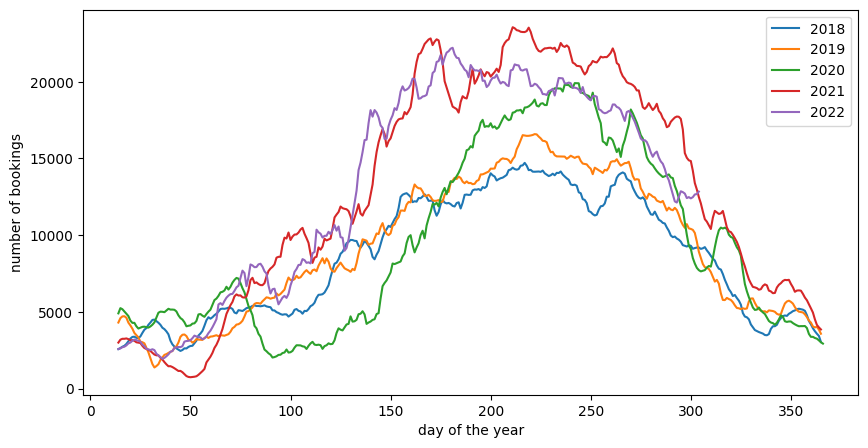

In [87]:
fig, ax = plt.subplots(1,1, figsize = (10,5))
count_dayofyear_2018.rolling(window=14).mean().plot(ax=ax)
count_dayofyear_2019.rolling(window=14).mean().plot(ax=ax)
count_dayofyear_2020.rolling(window=14).mean().plot(ax=ax)
count_dayofyear_2021.rolling(window=14).mean().plot(ax=ax)
count_dayofyear_2022.rolling(window=14).mean().plot(ax=ax)
ax.legend(['2018','2019','2020','2021','2022'])
ax.set_xlabel('day of the year')
ax.set_ylabel('number of bookings');

## 5. Distribution of trip duration

### 5.1 Trip duration in 2018

In [23]:
df_2018[df_2018['trip_duration_hrs'] <= 1][['trip_duration_hrs','Season']].hvplot.box(y='trip_duration_hrs', by='Season', ylabel='trip_duration',legend=False, 
                 width=500, height=500, padding=0.4)

:BoxWhisker   [Season]   (trip_duration_hrs)

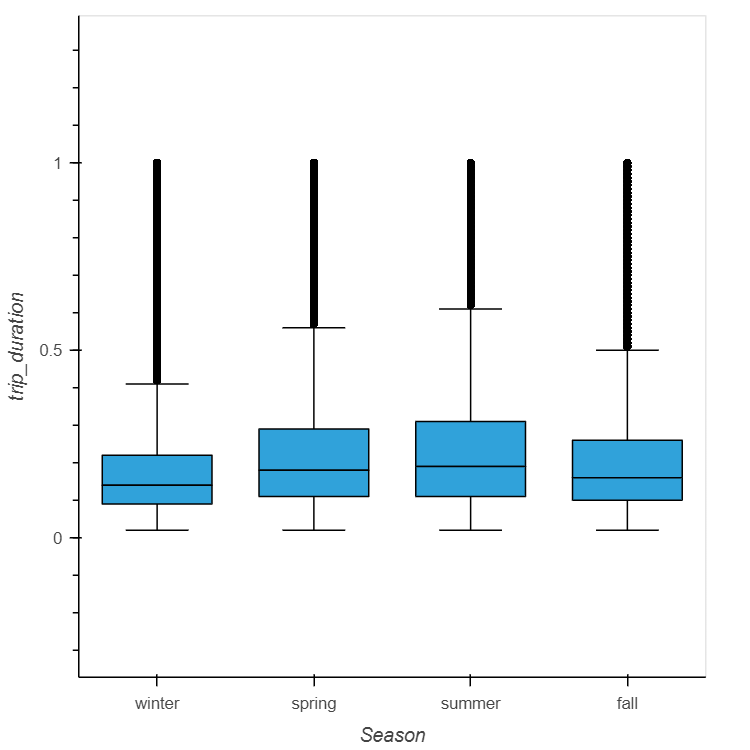

In [59]:
from IPython.display import Image
Image(filename='figure1.png')

In [36]:
df_2018[df_2018['trip_duration_hrs'] <= 1][['trip_duration_hrs','day_of_week']].hvplot.box(y='trip_duration_hrs', by='day_of_week', ylabel='trip_duration',legend=False, 
                 width=500, height=500, padding=0.4)

:BoxWhisker   [day_of_week]   (trip_duration_hrs)

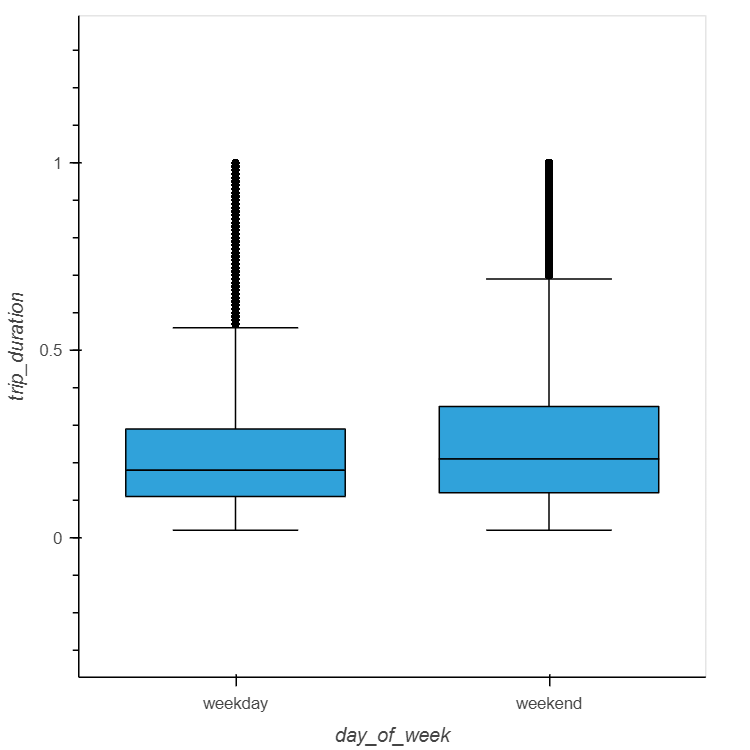

In [64]:
Image(filename='figure2.png')

In [43]:
df_2018[(df_2018['day_of_week'] == 'weekend') & (df_2018['trip_duration_hrs'] <= 1)][['trip_duration_hrs','Season']].hvplot.box(y='trip_duration_hrs', by='Season', ylabel='trip duration on weekends',legend=False, 
                 width=500, height=500, padding=0.4)

:BoxWhisker   [Season]   (trip_duration_hrs)

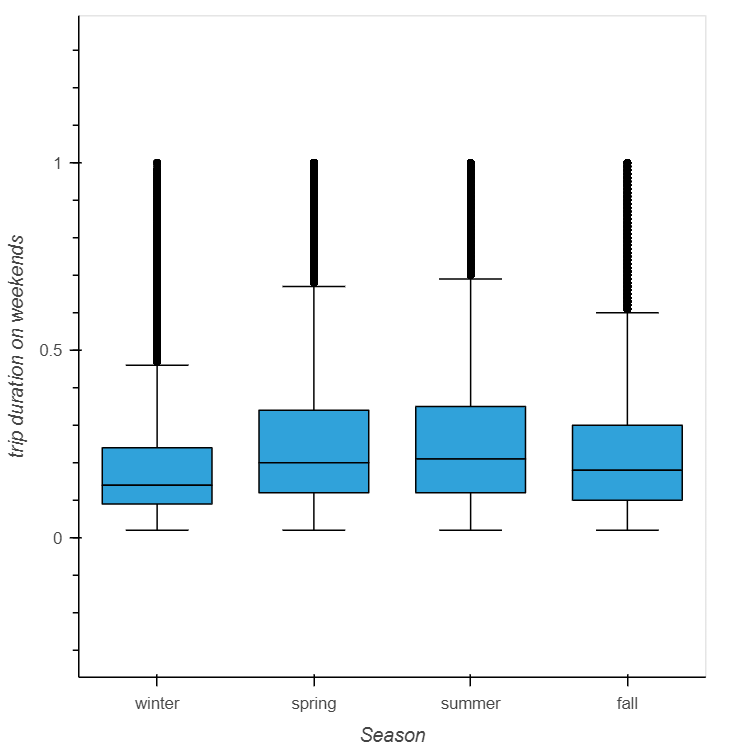

In [65]:
Image(filename='figure3.png')

### 5.2 Trip duration in 2019

In [26]:
df_2019[df_2019['trip_duration_hrs'] <= 1][['trip_duration_hrs','Season']].hvplot.box(y='trip_duration_hrs', by='Season', ylabel='trip_duration',legend=False, 
                 width=500, height=500, padding=0.4)

:BoxWhisker   [Season]   (trip_duration_hrs)

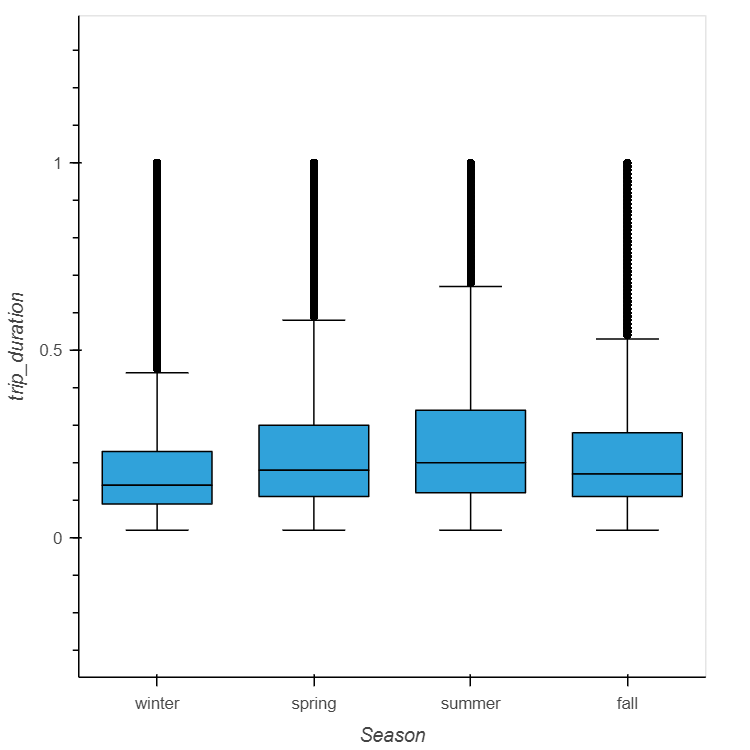

In [66]:
Image(filename='figure4.png')

In [37]:
df_2019[df_2019['trip_duration_hrs'] <= 1][['trip_duration_hrs','day_of_week']].hvplot.box(y='trip_duration_hrs', by='day_of_week', ylabel='trip_duration',legend=False, 
                 width=500, height=500, padding=0.4)

:BoxWhisker   [day_of_week]   (trip_duration_hrs)

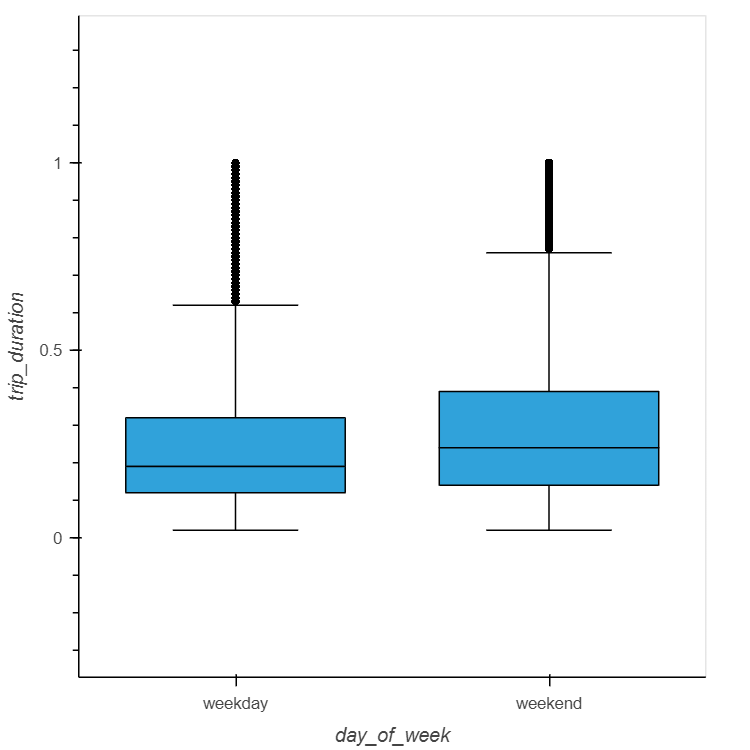

In [67]:
Image(filename='figure5.png')

In [44]:
df_2019[(df_2019['day_of_week'] == 'weekend') & (df_2019['trip_duration_hrs'] <= 1)][['trip_duration_hrs','Season']].hvplot.box(y='trip_duration_hrs', by='Season', ylabel='trip duration on weekends',legend=False, 
                 width=500, height=500, padding=0.4)

:BoxWhisker   [Season]   (trip_duration_hrs)

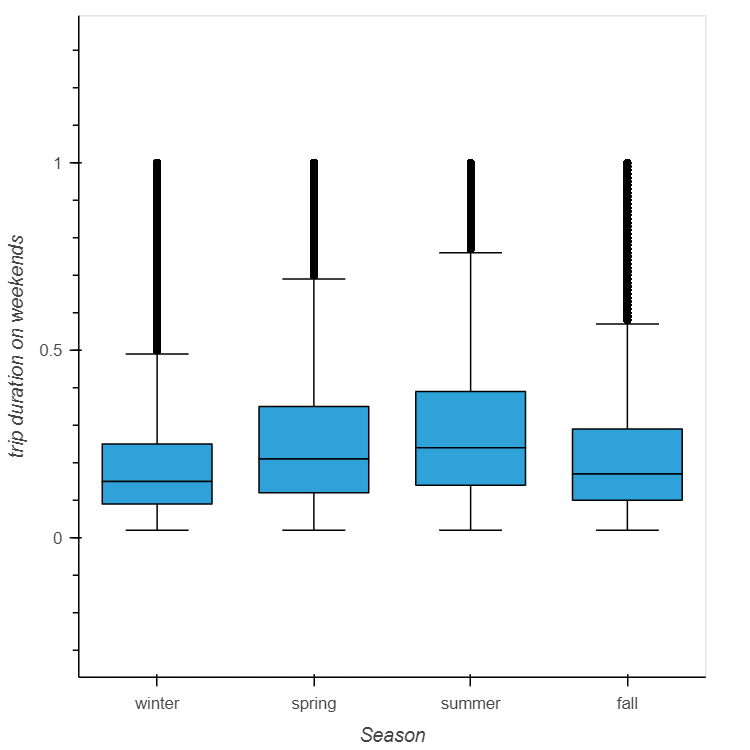

In [68]:
Image(filename='figure6.png')

### 5.3 Trip duration in 2020

In [27]:
df_2020[df_2020['trip_duration_hrs'] <= 1][['trip_duration_hrs','Season']].hvplot.box(y='trip_duration_hrs', by='Season', ylabel='trip_duration',legend=False, 
                 width=500, height=500, padding=0.4)

:BoxWhisker   [Season]   (trip_duration_hrs)

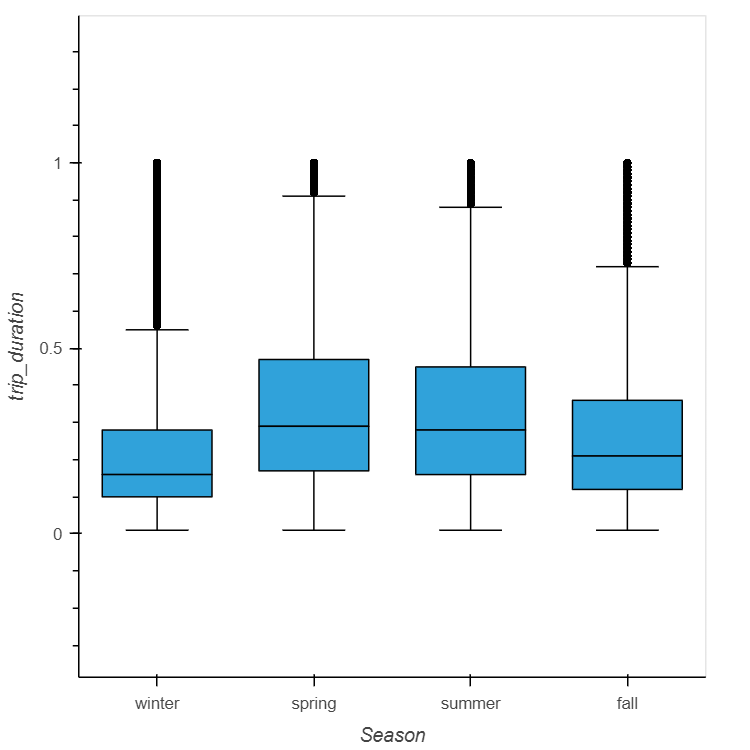

In [69]:
Image(filename='figure7.png')

In [38]:
df_2020[df_2020['trip_duration_hrs'] <= 1][['trip_duration_hrs','day_of_week']].hvplot.box(y='trip_duration_hrs', by='day_of_week', ylabel='trip_duration',legend=False, 
                 width=500, height=500, padding=0.4)

:BoxWhisker   [day_of_week]   (trip_duration_hrs)

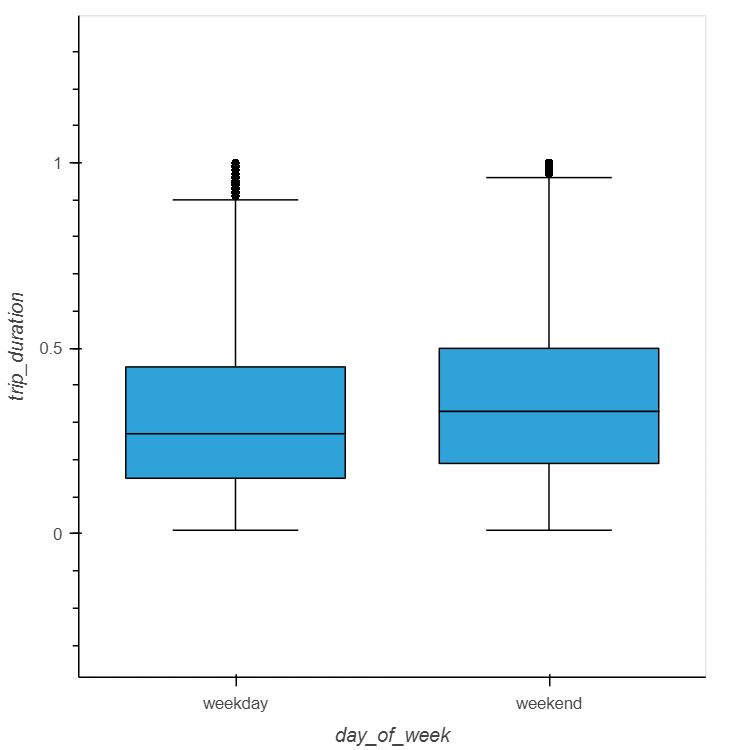

In [70]:
Image(filename='figure8.png')

In [46]:
df_2020[(df_2020['day_of_week'] == 'weekend') & (df_2020['trip_duration_hrs'] <= 1)][['trip_duration_hrs','Season']].hvplot.box(y='trip_duration_hrs', by='Season', ylabel='trip duration on weekends',legend=False, 
                 width=500, height=500, padding=0.4)

:BoxWhisker   [Season]   (trip_duration_hrs)

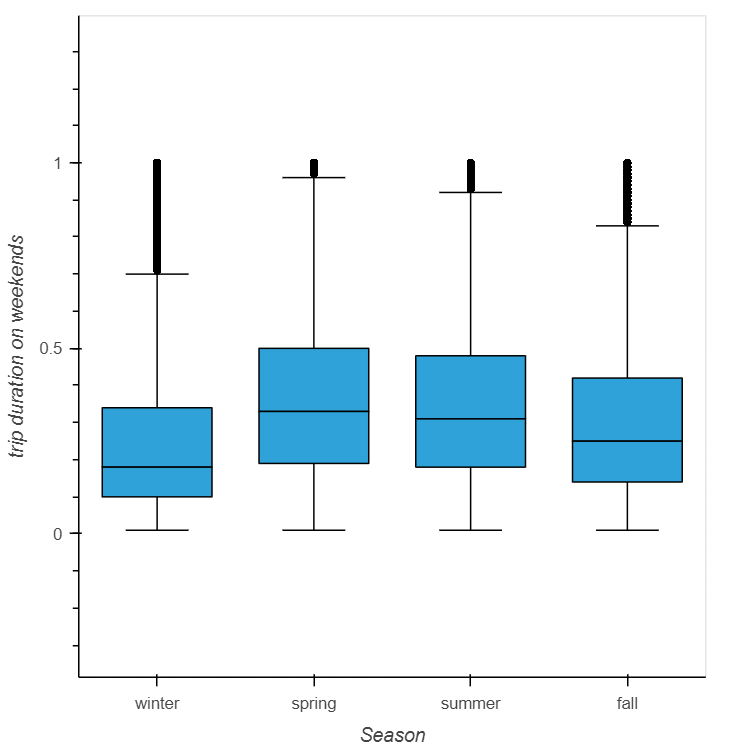

In [71]:
Image(filename='figure9.png')

### 5.4 Trip duration in 2021

In [28]:
df_2021[df_2021['trip_duration_hrs'] <= 1][['trip_duration_hrs','Season']].hvplot.box(y='trip_duration_hrs', by='Season', ylabel='trip_duration',legend=False, 
                 width=500, height=500, padding=0.4)

:BoxWhisker   [Season]   (trip_duration_hrs)

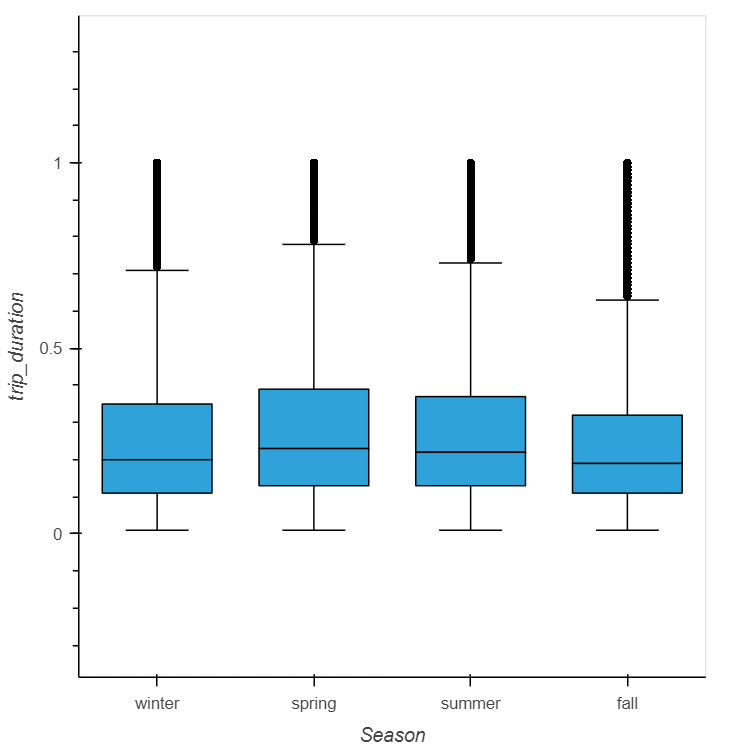

In [72]:
Image(filename='figure10.png')

In [39]:
df_2021[df_2021['trip_duration_hrs'] <= 1][['trip_duration_hrs','day_of_week']].hvplot.box(y='trip_duration_hrs', by='day_of_week', ylabel='trip_duration',legend=False, 
                 width=500, height=500, padding=0.4)

:BoxWhisker   [day_of_week]   (trip_duration_hrs)

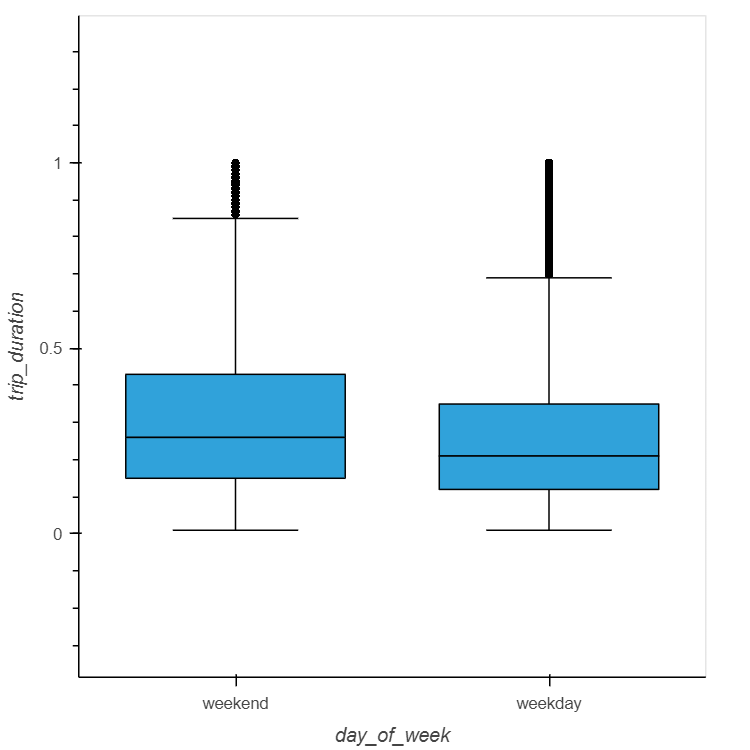

In [73]:
Image(filename='figure11.png')

In [47]:
df_2021[(df_2021['day_of_week'] == 'weekend') & (df_2021['trip_duration_hrs'] <= 1)][['trip_duration_hrs','Season']].hvplot.box(y='trip_duration_hrs', by='Season', ylabel='trip duration on weekends',legend=False, 
                 width=500, height=500, padding=0.4)

:BoxWhisker   [Season]   (trip_duration_hrs)

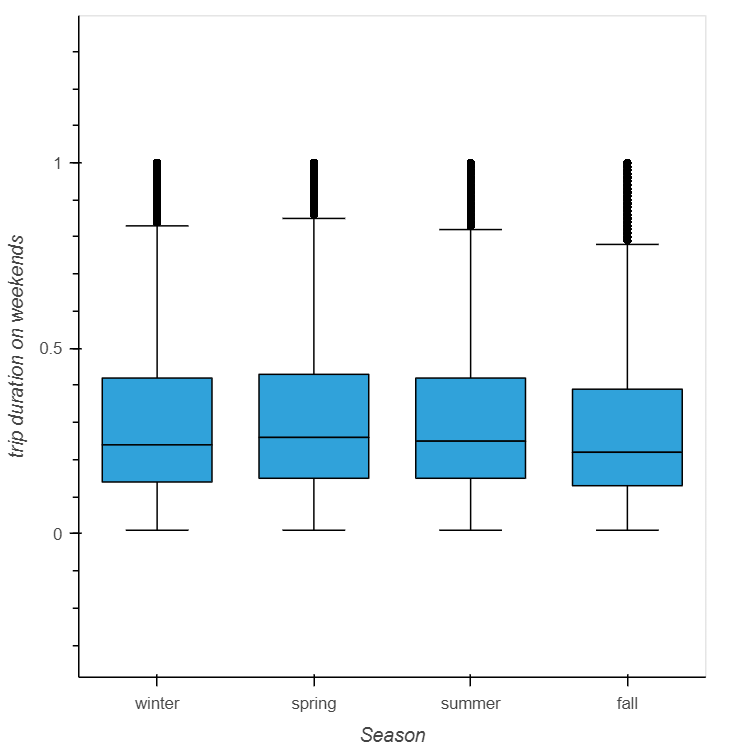

In [74]:
Image(filename='figure12.png')

### 5.5 Trip duration in 2022

In [29]:
df_2022[df_2022['trip_duration_hrs'] <= 1][['trip_duration_hrs','Season']].hvplot.box(y='trip_duration_hrs', by='Season', ylabel='trip_duration',legend=False, 
                 width=500, height=500, padding=0.4)

:BoxWhisker   [Season]   (trip_duration_hrs)

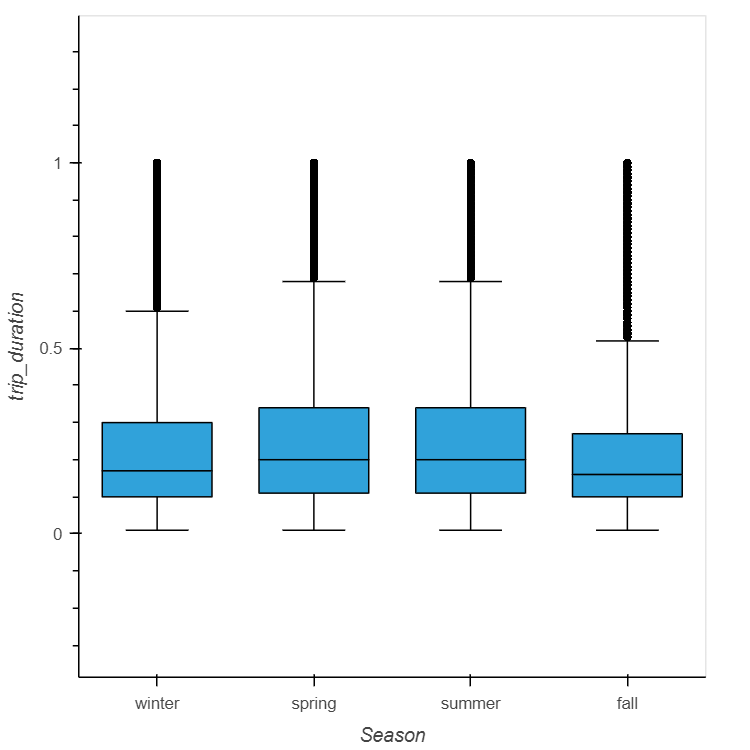

In [76]:
Image(filename='figure13.png')

In [40]:
df_2022[df_2022['trip_duration_hrs'] <= 1][['trip_duration_hrs','day_of_week']].hvplot.box(y='trip_duration_hrs', by='day_of_week', ylabel='trip_duration',legend=False, 
                 width=500, height=500, padding=0.4)

:BoxWhisker   [day_of_week]   (trip_duration_hrs)

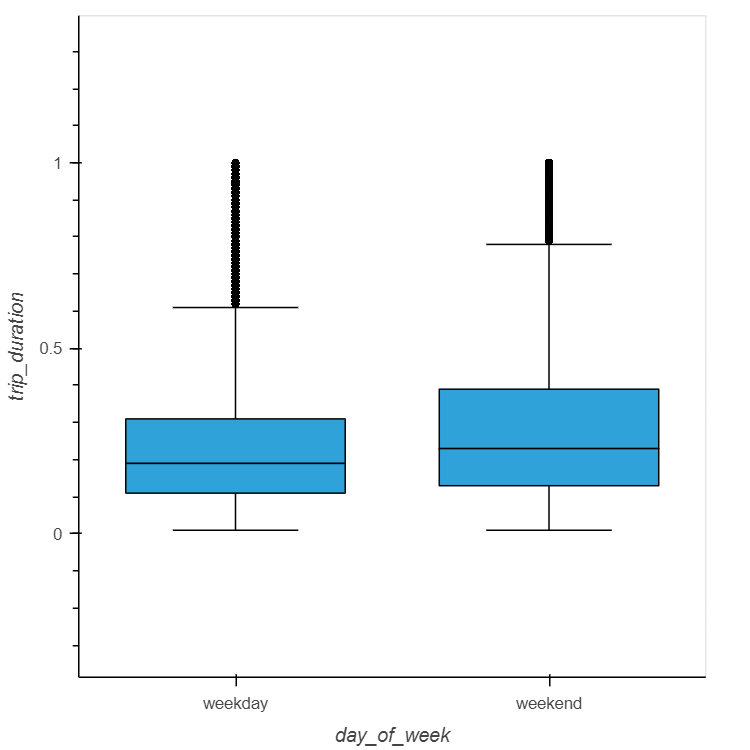

In [77]:
Image(filename='figure14.png')

In [48]:
df_2022[(df_2022['day_of_week'] == 'weekend') & (df_2022['trip_duration_hrs'] <= 1)][['trip_duration_hrs','Season']].hvplot.box(y='trip_duration_hrs', by='Season', ylabel='trip duration on weekends',legend=False, 
                 width=500, height=500, padding=0.4)

:BoxWhisker   [Season]   (trip_duration_hrs)

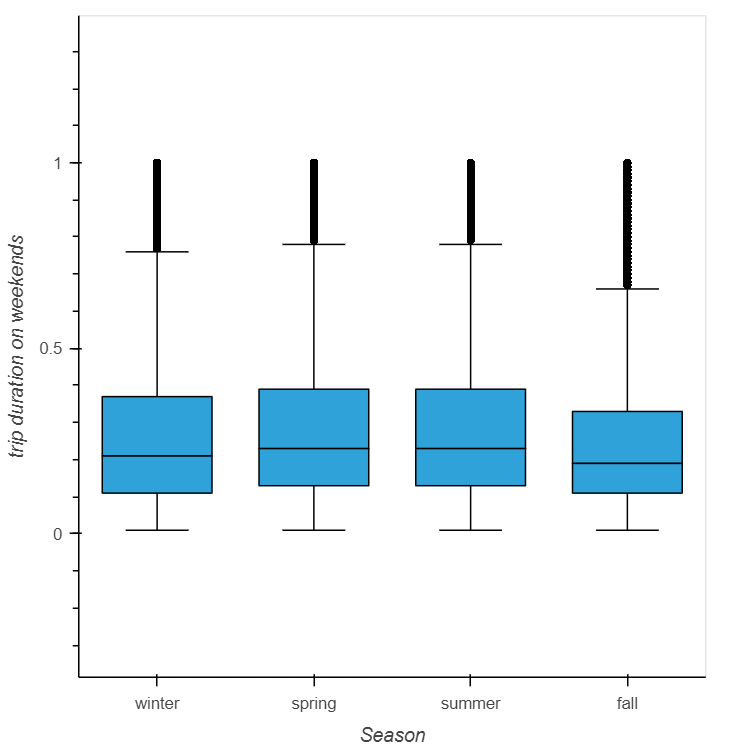

In [78]:
Image(filename='figure15.png')

For all years, the distribution of trip duration is skewed towards shorter durations. The median trip duration in 2018, 2019, 2022 is about 12 minutes, about 15 minutes in 2021, and about 18 minutes in 2020. 75% of the trips last less than 24 minutes, which likely correspond to commuting for work. Trips on the weekend tend to be longer than on weekdays. And trips in the spring and summer tend to be longer than in the winter and fall.

### 6. Bookings by day across the years

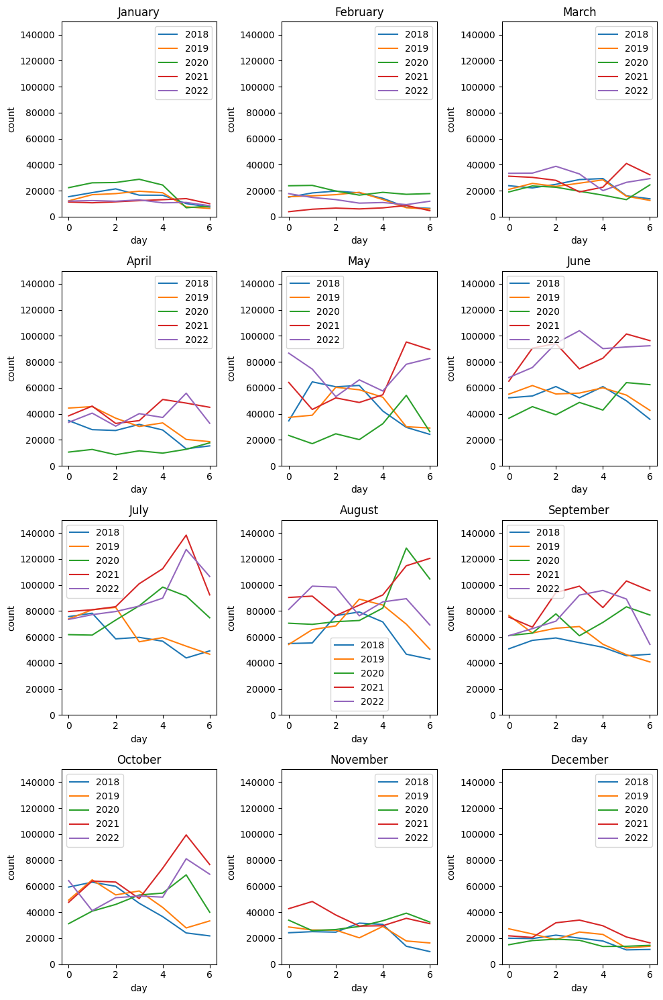

In [95]:
replace_dict = {'trip_id' : 'ride_id'}
df_2018 = df_2018.rename(columns = replace_dict)
df_2019 = df_2019.rename(columns = replace_dict)
all_years_dfs = [df_2018, df_2019, df_2020, df_2021, df_2022]
month_dictionary = {1 : 'January', 2: 'February', 3: 'March', 4: 'April', 
                    5: 'May', 6: 'June', 7: 'July', 8: 'August', 9: 'September', 
                    10: 'October', 11: 'November', 12: 'December'}

fig, ax = plt.subplots(4,3, figsize = (10,15))
for i in list(range(1,13)):
    for df in all_years_dfs:
        df_month = df[df['started_at_month'] == i]
        count = df_month.groupby('started_at_day').count().compute()['ride_id']
        if i <= 3:
            count.plot(ax = ax[0][(i-1)%3])
            ax[0][(i-1)%3].set_title(month_dictionary[i])
            ax[0][(i-1)%3].set_ylabel('count')
            ax[0][(i-1)%3].set_ylim(0,150000)
            ax[0][(i-1)%3].set_xlabel('day')
            ax[0][(i-1)%3].legend(['2018','2019','2020','2021','2022'])
        if i > 3 and i <= 6:
            count.plot(ax = ax[1][(i-1)%3])
            ax[1][(i-1)%3].set_title(month_dictionary[i])
            ax[1][(i-1)%3].set_ylabel('count')
            ax[1][(i-1)%3].set_ylim(0,150000)
            ax[1][(i-1)%3].set_xlabel('day')
            ax[1][(i-1)%3].legend(['2018','2019','2020','2021','2022'])
        if i > 6 and i <= 9:
            count.plot(ax = ax[2][(i-1)%3])
            ax[2][(i-1)%3].set_title(month_dictionary[i])
            ax[2][(i-1)%3].set_ylabel('count')
            ax[2][(i-1)%3].set_ylim(0,150000)
            ax[2][(i-1)%3].set_xlabel('day')
            ax[2][(i-1)%3].legend(['2018','2019','2020','2021','2022'])
        if i > 9 and i <= 12:
            count.plot(ax = ax[3][(i-1)%3])
            ax[3][(i-1)%3].set_title(month_dictionary[i])
            ax[3][(i-1)%3].set_ylabel('count')
            ax[3][(i-1)%3].set_ylim(0,150000)
            ax[3][(i-1)%3].set_xlabel('day')
            ax[3][(i-1)%3].legend(['2018','2019','2020','2021','2022'])
plt.tight_layout()
plt.show()

For all months of the year in 2018 and 2019, we have more bookings during the work week (Mon - Fri), than on the weekend. at the start of 2020 (January and February), we have a greater number of bookings compared to 2018 and 2019. In March and April of 2020, we see that the number of bookings fall below those in 2018, 2019, and 2021 and 2022 as well. This is likely due to the pandemic. People started isolating and working from home to avoid contracting the covid-19. However, bookings do start to pick up from June to October. In addition to this, as opposed to 2018 and 2019, there are more bookings during the weekend compared to weekdays. 

### 7. Bookings by hour across the years

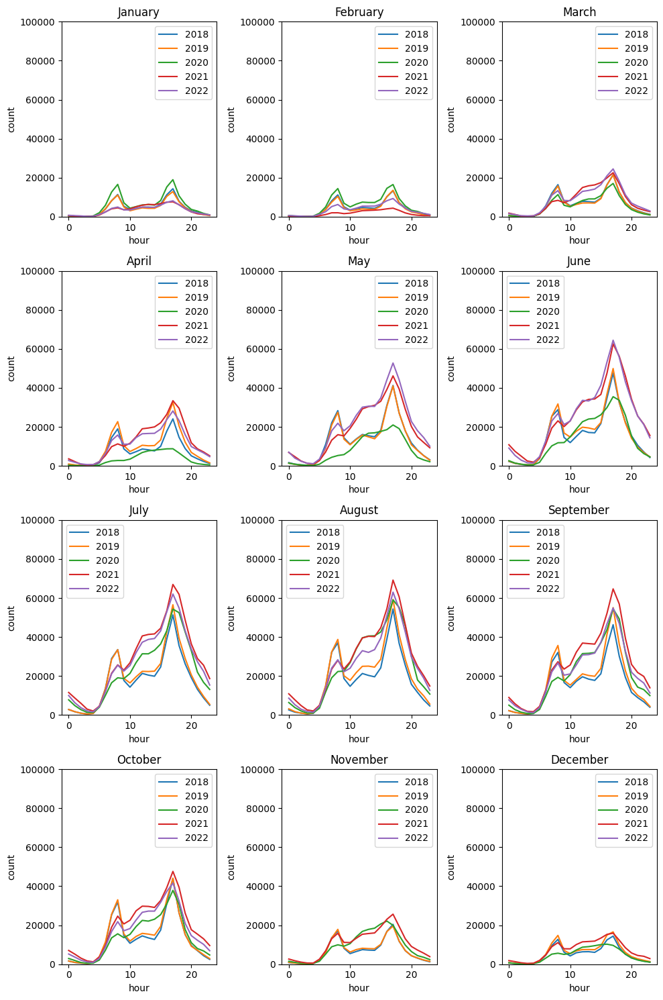

In [96]:
all_years_dfs = [df_2018, df_2019, df_2020, df_2021, df_2022]
month_dictionary = {1 : 'January', 2: 'February', 3: 'March', 4: 'April', 
                    5: 'May', 6: 'June', 7: 'July', 8: 'August', 9: 'September', 
                    10: 'October', 11: 'November', 12: 'December'}
fig, ax = plt.subplots(4,3, figsize = (10,15))
for i in list(range(1,13)):
    for df in all_years_dfs:
        df_month = df[df['started_at_month'] == i]
        count = df_month.groupby('started_at_hr').count().compute()['ride_id']
        if i <= 3:
            count.plot(ax = ax[0][(i-1)%3])
            ax[0][(i-1)%3].set_title(month_dictionary[i])
            ax[0][(i-1)%3].set_ylabel('count')
            ax[0][(i-1)%3].set_ylim(0,100000)
            ax[0][(i-1)%3].set_xlabel('hour')
            ax[0][(i-1)%3].legend(['2018','2019','2020','2021','2022'])
        if i > 3 and i <= 6:
            count.plot(ax = ax[1][(i-1)%3])
            ax[1][(i-1)%3].set_title(month_dictionary[i])
            ax[1][(i-1)%3].set_ylabel('count')
            ax[1][(i-1)%3].set_ylim(0,100000)
            ax[1][(i-1)%3].set_xlabel('hour')
            ax[1][(i-1)%3].legend(['2018','2019','2020','2021','2022'])
        if i > 6 and i <= 9:
            count.plot(ax = ax[2][(i-1)%3])
            ax[2][(i-1)%3].set_title(month_dictionary[i])
            ax[2][(i-1)%3].set_ylabel('count')
            ax[2][(i-1)%3].set_ylim(0,100000)
            ax[2][(i-1)%3].set_xlabel('hour')
            ax[2][(i-1)%3].legend(['2018','2019','2020','2021','2022'])
        if i > 9 and i <= 12:
            count.plot(ax = ax[3][(i-1)%3])
            ax[3][(i-1)%3].set_title(month_dictionary[i])
            ax[3][(i-1)%3].set_ylabel('count')
            ax[3][(i-1)%3].set_ylim(0,100000)
            ax[3][(i-1)%3].set_xlabel('hour')
            ax[3][(i-1)%3].legend(['2018','2019','2020','2021','2022'])
plt.tight_layout()
plt.show()

There are two peaks in all months that correspond to bookings made for commuting in the morning and in the evening. The bookings increase during the warmer months, from April to October. In January and February months of 2021 and 2022 we don't observe peaks, likely due to people deciding to work from home to avoid the cold weather. April and May of 2020 show the lowest number of bookings compared to the years before and after, likely due to people having to isolate and work from home because of the pandemic. 

### 8. Weekday vs. weekend bookings

In [35]:
weekend_bookings = df[df['started_at_day'].isin([5,6])]
weekday_bookings = df[~df['started_at_day'].isin([5,6])]

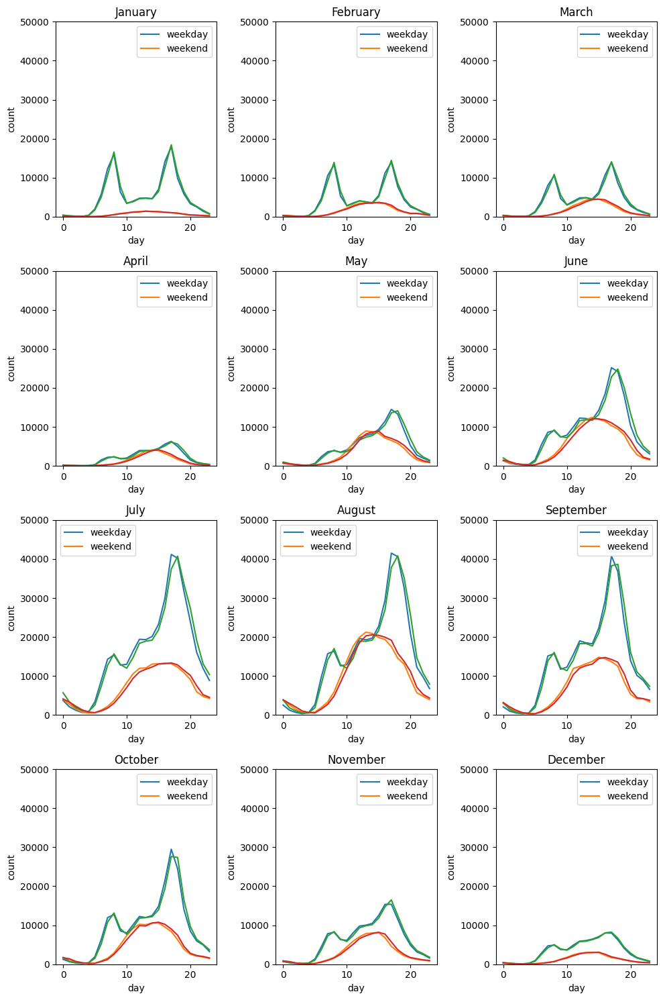

In [51]:
fig, ax = plt.subplots(4,3, figsize = (10,15))
for i in list(range(1,13)):
    for item in hr_list:
        weekday_month = weekday_bookings[weekday_bookings['started_at_month'] == i]
        weekday_count = weekday_month.groupby(item).count().compute()['ride_id']
        weekend_month = weekend_bookings[weekend_bookings['started_at_month'] == i]
        weekend_count = weekend_month.groupby(item).count().compute()['ride_id']
        if i <= 3:
            weekday_count.plot(ax = ax[0][(i-1)%3])
            weekend_count.plot(ax = ax[0][(i-1)%3])
            ax[0][(i-1)%3].set_title(month_dictionary[i])
            ax[0][(i-1)%3].set_ylabel('count')
            ax[0][(i-1)%3].set_ylim(0,50000)
            ax[0][(i-1)%3].set_xlabel('hour')
            ax[0][(i-1)%3].legend(['weekday','weekend'])
        if i > 3 and i <= 6:
            weekday_count.plot(ax = ax[1][(i-1)%3])
            weekend_count.plot(ax = ax[1][(i-1)%3])
            ax[1][(i-1)%3].set_title(month_dictionary[i])
            ax[1][(i-1)%3].set_ylabel('count')
            ax[1][(i-1)%3].set_ylim(0,50000)
            ax[1][(i-1)%3].set_xlabel('hour')
            ax[1][(i-1)%3].legend(['weekday','weekend'])
        if i > 6 and i <= 9:
            weekday_count.plot(ax = ax[2][(i-1)%3])
            weekend_count.plot(ax = ax[2][(i-1)%3])
            ax[2][(i-1)%3].set_title(month_dictionary[i])
            ax[2][(i-1)%3].set_ylabel('count')
            ax[2][(i-1)%3].set_ylim(0,50000)
            ax[2][(i-1)%3].set_xlabel('hour')
            ax[2][(i-1)%3].legend(['weekday','weekend'])
        if i > 9 and i <= 12:
            weekday_count.plot(ax = ax[3][(i-1)%3])
            weekend_count.plot(ax = ax[3][(i-1)%3])
            ax[3][(i-1)%3].set_title(month_dictionary[i])
            ax[3][(i-1)%3].set_ylabel('count')
            ax[3][(i-1)%3].set_ylim(0,50000)
            ax[3][(i-1)%3].set_xlabel('hour')
            ax[3][(i-1)%3].legend(['weekday','weekend'])
plt.tight_layout()
plt.show()

On weekdays, from January through March, we observe two peaks. One in the morning and one in the evening. These correspond to people commuting to and from work. From April to October, the number of rides increases. Because the weather is warmer, people book the bikes more in the evening. Evening bookings decrease from October to December. Weekend bookings are the highest in the afternoon from June to September. 

### 9. What are the most popular stations?

#### Most popular starting station in each year

In [25]:
all_years_dfs = [df_2020, df_2021, df_2022]
years = ['2020', '2021', '2022']
count_dfs = []
for df in all_years_dfs:
    count_start_station_usage = df.groupby('start_station_id').count().sort_values(by = 'ride_id', ascending = False)['ride_id']
    start_station_info = df.groupby("start_station_id").first()[['start_station_name','start_lat','start_lng']]
    count_df = start_station_info.merge(pd.DataFrame(count_start_station_usage, index = count_start_station_usage.index, columns = ['count']))
    count_df = count_df.reset_index()
    count_df = count_df.compute()
    count_dfs.append(count_df)
    #count_df.sort_values(by = 'count', ascending = False).head(5)
    #print(years[all_years_dfs.index(df)])

In [40]:
for i in range(3):
    print(years[i])
    print(count_dfs[i].sort_values(by ='count', ascending = False)[['start_station_name', 'count']])

2020
             start_station_name  count
265     Streeter Dr & Grand Ave  34348
78            Clark St & Elm St  29977
79          Theater on the Lake  28519
584   Lake Shore Dr & Monroe St  28012
175  Lake Shore Dr & North Blvd  25687
..                          ...    ...
939        Halsted St & 51st St      1
668     Hegewisch Metra Station      1
918     Marquette Ave & 89th St      1
919       Houston Ave & 92nd St      1
991    Kedzie Ave & Harrison St      1

[1225 rows x 2 columns]
2021
                     start_station_name  count
7               Streeter Dr & Grand Ave  79846
444          Lake Shore Dr & North Blvd  46232
108           Lake Shore Dr & Monroe St  44532
14                Michigan Ave & Oak St  42542
576               Wells St & Concord Ln  41429
..                                  ...    ...
810  N Shore Channel Trail & Argyle Ave      1
763              Indiana Ave & 133rd St      1
688     Lyft Driver Center Private Rack      1
799           Sacramento Bl

The most popular station is 'Streeter Dr & Grand Ave', which is the station close to Lake Shore Drive by Navy Pier. This is probably due to riders booking the bikes for leisure. 

In [58]:
fig = px.scatter_mapbox(count_dfs[2], 
                        lat=1, 
                        lon=2, 
                        hover_name=0, 
                        hover_data=[1, 2],
                        color=count_dfs[2]['count'],
                        color_continuous_scale=px.colors.sequential.Turbo,
                        size=count_dfs[2]['count'],
                        zoom=8, 
                        height=800,
                        width=800)

fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

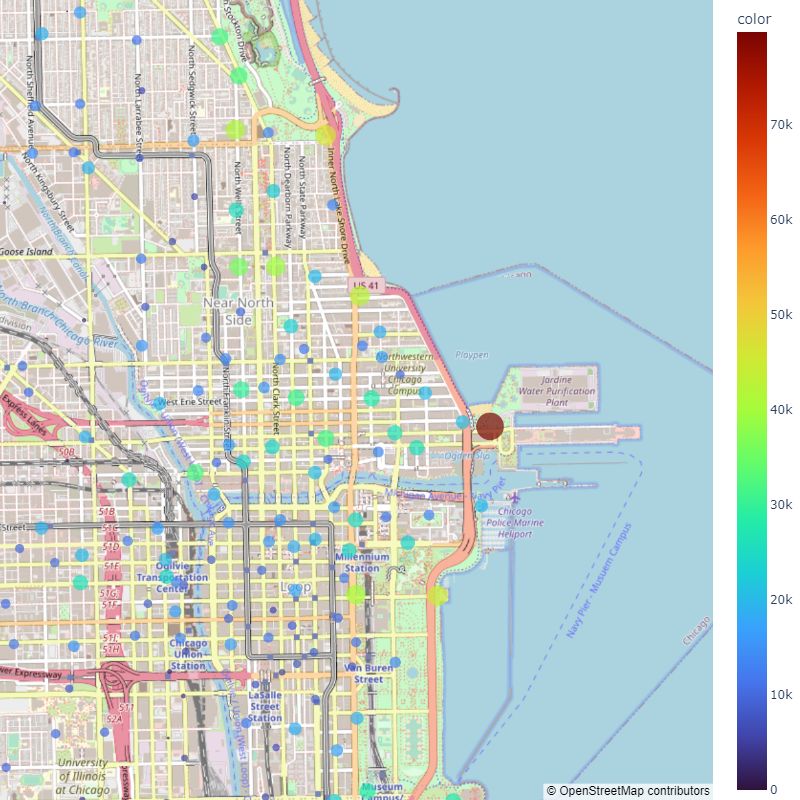

In [60]:
Image(filename='newplot1.png')